# Studying the coverage of FourSquare crowdsourcing data for restaurants in the city of Mumbai

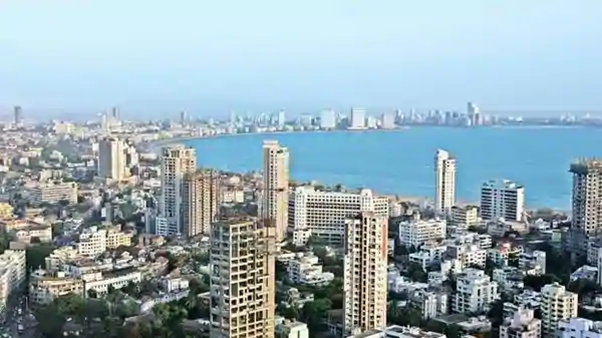

## Table of contents
* [Introduction](#introduction)
* [Data](#data)
* [Methodology](#methodology)
* [Analysis](#analysis)
* [Results and Discussion](#results)
* [Conclusion](#conclusion)

 ## Introduction <a name="introduction"></a>

Foursquare is a service that provides crowdsourced data for various venues nearby your location. However, as a native of Mumbai, I found that Foursquare data for the area was lacking.

This study aims to qualitatively understand the lack of data in this region. It will limit itself to the scope of restaurants and other eateries, and compare the Foursquare data with a relatively complete data obtained from Zomato.

The results of this study can help quantify the coverage difference between Foursquare, a US based service and Zomato, an India based service.

## Data <a name="Data"></a>

For this study, we will make use of the following data:

1.	Mumbai Data
       
       a.	Post offices and Pin Codes: 
        This Data encompasses a list of pin codes, local post office names and the governing districts. It will provide a way to segregate localities on basis of a definite locations
        We will limit our scope to Mumbai only.
        
        Source: https://mumbai7.com/postal-codes-in-mumbai/
        

2.	Restaurant Data

        a.	Foursquare API:
        API requests to Foursquare will provide the currently documented restaurants and eateries in the vicinity of the post offices.

        b.	Zomato API:
        API requests to Zomato will provide the currently documented restaurants and eateries. This data will be considered more accurate and used to compare the Foursquare data

### Import libraries and dependencies


In [1]:
import numpy as np # library to handle data in a vectorized manner
import pandas as pd
#!pip install haversine
import haversine
#!pip install folium
import folium
#!pip install geopy
from geopy.geocoders import Nominatim # module to convert an address into latitude and longitude values
#!pip install lxml
#!pip3 install requests beautifulsoup4
from bs4 import BeautifulSoup
import requests
import pandas.io.json as json
import lxml.html as lh
from sklearn.cluster import KMeans
print("Libraries imported.")

pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', None)

Libraries imported.


### Acquiring Locality Data

In order to acquire the venue distribution from FourSquare and Zomato APIs, we need a set of localities to call the APIs on. 

To do this, we first use a dataset of Pin Codes and corresponding post offices in the Mumbai Region. We will use the post office names as corresponding names of localities.

An easily available resource is the webpage https://mumbai7.com/postal-codes-in-mumbai/. We scrape the data from the page and write to an HTML file for offline use.

In [2]:
link = 'https://mumbai7.com/postal-codes-in-mumbai/'
headers = {'User-Agent': 'Mozilla/5.0 (Macintosh; Intel Mac OS X 10.12; rv:55.0) Gecko/20100101 Firefox/55.0',}

page = requests.get(link,headers=headers)

with open('Mumbai_PinCodes.html', 'wb') as fOut:
    fOut.write(page.content)

### City Data


We start by reading the html file into a pandas dataframe.

In [3]:
df1 = pd.read_html("D:\Code\Coursera_Capstone\Mumbai_PinCodes.html")
df1 = df1[0]

df1

,City,Post Office,Pin Code
0,Mumbai,August Kranti Marg,400036
1,Mumbai,Aarey Milk Colony,400065
2,Mumbai,Andheri (East),400069
3,Mumbai,Andheri (West),400058
4,Mumbai,Antop Hill,400037
5,Mumbai,Anu Shakti Nagar,400094
6,Mumbai,B A R C,400085
7,Mumbai,Ballard Estate,400038
8,Mumbai,Bandra (East),400051
9,Mumbai,Bandra (West),400050


We see that the city column has entries from Mumbai, Thane, and Navi Mumbai. Since we are limiting our scope to only the limits of Mumbai, we filter out the dataframe and create the required columns for the next step 

In [4]:
df2 = df1[df1['City']=='Mumbai']
df2 = df2.rename(columns={'Post Office':'Locality'})
df2["Latitude"] = ""
df2["Longitude"] = ""
print(df2.count())

df2.head(10)

City         94
Locality     94
Pin Code     94
Latitude     94
Longitude    94
dtype: int64


,City,Locality,Pin Code,Latitude,Longitude
0,Mumbai,August Kranti Marg,400036,,
1,Mumbai,Aarey Milk Colony,400065,,
2,Mumbai,Andheri (East),400069,,
3,Mumbai,Andheri (West),400058,,
4,Mumbai,Antop Hill,400037,,
5,Mumbai,Anu Shakti Nagar,400094,,
6,Mumbai,B A R C,400085,,
7,Mumbai,Ballard Estate,400038,,
8,Mumbai,Bandra (East),400051,,
9,Mumbai,Bandra (West),400050,,


We see that we have obtained a 94 different localities from the Pin Code data. We have also initialised empty columns for locality coordinates. Next, we attempt to fill these.

### Ascribing Geolocation data and creating Dataframe

In order to pass API requests for all the localities, we need representative coordinates for them. This we obtain by using the Nominatim API.

First, we create a function to get coordinates corresponding to locality names for our dataframe. It will assign the coordinates and return an error index containing values for locality names that were not recognised by Nominatim

In [5]:
def getCoordinatesMumbai(indices,names):
    #from geopy.geocoders import Nominatim
    error_index = []
    for ind, name in zip(indices,names):
        geolocator = Nominatim(user_agent="to_explorer")
        address = name + ', Mumbai'
        location = geolocator.geocode(address,timeout=None)
        if location is None:
            latitude = None
            longitude = None
            print("\nGeographical Coordinates not found for {} at index {}".format(address,ind))
            error_index.append(ind)
        else:
            latitude = location.latitude
            longitude = location.longitude
            print(".",end='')
        df2.loc[int(ind), 'Latitude']  = latitude
        df2.loc[int(ind), 'Longitude'] = longitude
    
    print("done!")
    return error_index

In [6]:
error_index = getCoordinatesMumbai(df2.index,df2['Locality'])
print("Error index is {}".format(error_index))
df2.head(10)

.....
Geographical Coordinates not found for Anu Shakti Nagar, Mumbai at index 5

Geographical Coordinates not found for B A R C, Mumbai at index 6
.......
Geographical Coordinates not found for Bhavani Shankar Road, Mumbai at index 14
................................................
Geographical Coordinates not found for N I T I E, Mumbai at index 63
....
Geographical Coordinates not found for Poonam Ngr Jogeshwari (E), Mumbai at index 68
..
Geographical Coordinates not found for Rajbhavan, Mumbai at index 71
..............
Geographical Coordinates not found for Veer Jijamata Bhosle Udyan, Mumbai at index 86

Geographical Coordinates not found for Vesava (Versova), Mumbai at index 87

Geographical Coordinates not found for Vidyanagari, Mumbai at index 88
.....done!
Error index is [5, 6, 14, 63, 68, 71, 86, 87, 88]


,City,Locality,Pin Code,Latitude,Longitude
0,Mumbai,August Kranti Marg,400036,18.9643,72.8062
1,Mumbai,Aarey Milk Colony,400065,19.1561,72.8707
2,Mumbai,Andheri (East),400069,19.1159,72.8542
3,Mumbai,Andheri (West),400058,19.1172,72.834
4,Mumbai,Antop Hill,400037,19.0208,72.8653
5,Mumbai,Anu Shakti Nagar,400094,None,None
6,Mumbai,B A R C,400085,None,None
7,Mumbai,Ballard Estate,400038,18.9367,72.8391
8,Mumbai,Bandra (East),400051,19.0617,72.8498
9,Mumbai,Bandra (West),400050,19.0583,72.8303


Studying the errors, we see that many of them are generated due to misspellings/abbreviations/whitespaces. These can be replaced easily. (Validity of replacements can be checked manually using https://nominatim.openstreetmap.org)

The Error index returned gives us values for locality names which need to be replaced.

In [7]:
df2["Locality"].loc[error_index] = ["Anushakti Nagar", "BARC", "Bhavanishankar Road", "NITIE", "Poonam Nagar",
                                   "Raj Bhavan", "Rani Baug", "Versova", "Vidya Nagari"]

error_index2 = getCoordinatesMumbai(error_index,(df2['Locality'].loc[error_index]))
print("Error index is {}".format(error_index2))
df2.head(10)

C:\Users\rahul\anaconda3\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


.........done!
Error index is []


,City,Locality,Pin Code,Latitude,Longitude
0,Mumbai,August Kranti Marg,400036,18.9643,72.8062
1,Mumbai,Aarey Milk Colony,400065,19.1561,72.8707
2,Mumbai,Andheri (East),400069,19.1159,72.8542
3,Mumbai,Andheri (West),400058,19.1172,72.834
4,Mumbai,Antop Hill,400037,19.0208,72.8653
5,Mumbai,Anushakti Nagar,400094,19.0396,72.9222
6,Mumbai,BARC,400085,19.0175,72.9246
7,Mumbai,Ballard Estate,400038,18.9367,72.8391
8,Mumbai,Bandra (East),400051,19.0617,72.8498
9,Mumbai,Bandra (West),400050,19.0583,72.8303


#### Mapping the localities
In order to view the obtained locations for the list of localities, we use Folium.

First, we obtain the map coordinates for Mumbai. These will be used for all the Folium maps we generate.

In [8]:
address = 'Mumbai, India'
geolocator = Nominatim(user_agent="to_explore")
location = geolocator.geocode(address)
mumbai_latitude = location.latitude
mumbai_longitude = location.longitude
mumbai_coord = (mumbai_latitude,mumbai_longitude)
print('The geograpical coordinates of Mumbai, India are {}.'.format(mumbai_coord))

The geograpical coordinates of Mumbai, India are (19.0759899, 72.8773928).


Next, it is decided to use the OSM_Bright map from Stadia as the tiling for our maps. It has a higher contrast and lesser labeling, which is better for visualisation.

In [9]:
tile = 'https://tiles.stadiamaps.com/tiles/osm_bright/{z}/{x}/{y}{r}.png'

osm_bright = '&copy; <a href="https://stadiamaps.com/">Stadia Maps</a>, &copy; <a href="https://openmaptiles.org/">OpenMapTiles</a> &copy; <a href="http://openstreetmap.org">OpenStreetMap</a> contributors'

Finally, we map our Localities for visual inspection.

In [10]:
map_mumbai1 = folium.Map(location= mumbai_coord, zoom_start=11,control_scale=True, width=800,height = 600)
folium.TileLayer(tiles = tile, attr = osm_bright, name = "Localities").add_to(map_mumbai1)

# add markers to map
for lat, lng, local, pin, ind in zip(df2['Latitude'], df2['Longitude'], df2['Locality'], df2['Pin Code'],df2.index):
    label = '{},{},{}'.format(ind,local, pin)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_mumbai1)  
    
map_mumbai1

On careful inspection, we see that certain points are out of the bounds of Mumbai. Others are simply at the wrong place. Many points are too close to others to provide a relatively uniform cover. 

And finally, a few key areas have no localities assigned to them. All of these issues need to be corrected.

We begin first by sorting the dataframe on the coordinates to check for outliers

In [11]:
df2.sort_values(by=['Latitude'])

,City,Locality,Pin Code,Latitude,Longitude
23,Mumbai,Colaba,400005,18.9151,72.826
64,Mumbai,Nariman Point,400021,18.9253,72.818
55,Mumbai,Mantralaya,400032,18.9277,72.827
36,Mumbai,Hutatma Chowk,400023,18.9333,72.8314
7,Mumbai,Ballard Estate,400038,18.9367,72.8391
71,Mumbai,Raj Bhavan,400035,18.9411,72.7939
56,Mumbai,Marine Lines,400020,18.9457,72.8238
43,Mumbai,Kalbadevi,400002,18.9493,72.8279
32,Mumbai,Girgaon,400004,18.9543,72.8179
54,Mumbai,Mandvi,400003,18.9551,72.8348


We see that at index 24, Council Hall has coourdinates somewhere in the UK instead of in Mumbai. Thus it needs to be rectified.

Next we check if any points are being superimposed.

In [12]:
dupl = df2[df2.duplicated(['Latitude','Longitude'], keep = False)]
dupl

,City,Locality,Pin Code,Latitude,Longitude
16,Mumbai,Mumbai G P O,400001,19.0775,72.8094
17,Mumbai,Borivli (East),400066,19.2251,72.8502
18,Mumbai,Borivli (West),400092,19.2251,72.8502
30,Mumbai,F C I Mumbai,400074,19.0775,72.8094
38,Mumbai,J B Nagar,400059,19.076,72.8774
85,Mumbai,Tulsiwadi,400034,19.076,72.8774


Visually inpecting these locations leads to the realisation that they have to be renamed to accurately use Nominatim. We collect these indices in a list.

In addition, we add the indices of all the incorrectly placed Localities. They are all listed below

In [13]:
inaccurate1 = dupl.index.tolist()
inaccurate2 = [3,12,19,20,21,22,24,37,40,53,59,75,76,77,79,80,82,83,89,92,93]
inaccurate_loc = inaccurate1 + inaccurate2
inaccurate_loc.sort()
df2['Locality'].loc[inaccurate_loc]

3             Andheri (West)
12                   Bhandup
16              Mumbai G P O
17            Borivli (East)
18            Borivli (West)
19                Borivli HO
20              Chakala MIDC
21                   Chembur
22             Chinch Bunder
24              Council Hall
30              F C I Mumbai
37              I I T Mumbai
38                 J B Nagar
40         Jogeshwari (East)
53               Mandpeshwar
59             Motilal Nagar
75          Santacruz (East)
76          Santacruz (West)
77      Santacruz P&T Colony
79     Shivaji Nagar (Kurla)
80                      Sion
82                 Tank Road
83    Telecom Factory Deonar
85                 Tulsiwadi
89                  Vikhroli
92                    Wadala
93                     Worli
Name: Locality, dtype: object

We need to correct these names or replace them with alternate names. As a resident of Mumbai, the following list of names was created corresponding to each inaccuracy.

In [14]:
correct_loc_name = ['Cama Road',
                    'Bhandup West',
                    'Mumbai CSMT',
                    'Borivali East',
                    'Borivali West',
                    'Gorai Suburb',
                    'MIDC', 
                    'Chembur West',
                    'Dongri',
                    'Henry Road', 
                    'Fertilizer Colony',
                    'IIT Mumbai',
                    'Marol Village',
                    'Janata Colony', 
                    'Mount Poinsur',
                    'Oshiwara',
                    'Sen Nagar', 
                    'Tagore Road',
                    'Kalina Camp',
                    'Shivaji Nagar',
                    'Sion East', 
                    'Parel Tank Road', 
                    'BSNL Telecom Factory',
                    'Tulsi Wadi',
                    'Pirojsha Nagar',
                    'Wadala Village',
                    'Worli Koliwada']


df2["Locality"].loc[inaccurate_loc] = correct_loc_name

C:\Users\rahul\anaconda3\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


Lastly, we add and remove some entries. 

A few important localities not covered by the primary database (owing to the fact that they have the same pin code) were added.

August Kranti Marg, which lies between Malabar Hill, Cumballa Hill, Grant Road, hardly covers any area not covered by the other three. Hence it should be removed.

Pin 400038 has been discontinued, and the area falls under 400001. Hence it should be removed.

In [15]:
add_entries = pd.DataFrame([['Mumbai', 'Mahalakshmi', 400018],
                            ['Mumbai', 'Nagpada', 400008],
                            ['Mumbai', 'Madh', 400061],
                            ['Mumbai', 'Dindoshi', 400063],
                            ['Mumbai', 'Thakur Village', 400101],
                            ['Mumbai', 'Charkop', 400067],
                            ['Mumbai', 'Powai', 400071],
                            ['Mumbai', 'Lokhandwala', 400053],
                            ['Mumbai', 'Orlem', 400064],
                            ['Mumbai', 'Poisar', 400067]],
                            columns=['City','Locality','Pin Code'])

drop_entries = [0,7]

df2 = df2.append(add_entries,ignore_index=True)
df2 = df2.drop(drop_entries)

df2.head(10)

,City,Locality,Pin Code,Latitude,Longitude
1,Mumbai,Aarey Milk Colony,400065,19.1561,72.8707
2,Mumbai,Andheri (East),400069,19.1159,72.8542
3,Mumbai,Cama Road,400058,19.1172,72.834
4,Mumbai,Antop Hill,400037,19.0208,72.8653
5,Mumbai,Anushakti Nagar,400094,19.0396,72.9222
6,Mumbai,BARC,400085,19.0175,72.9246
8,Mumbai,Bandra (East),400051,19.0617,72.8498
9,Mumbai,Bandra (West),400050,19.0583,72.8303
10,Mumbai,Bangur Nagar,400090,19.1688,72.8337
11,Mumbai,Barve Nagar,400084,19.0953,72.9002


Finally we get the coordinates for all the corrections and new entries.

In [16]:
empty_coord = df2[df2['Latitude'].isnull()].index.tolist()
update_coord = inaccurate_loc + empty_coord
error_index3 = getCoordinatesMumbai(update_coord,(df2['Locality'].loc[update_coord]))
print("Error index is {}".format(error_index3))
df2

.....................................done!
Error index is []


,City,Locality,Pin Code,Latitude,Longitude
1,Mumbai,Aarey Milk Colony,400065,19.1561,72.8707
2,Mumbai,Andheri (East),400069,19.1159,72.8542
3,Mumbai,Cama Road,400058,19.1207,72.8439
4,Mumbai,Antop Hill,400037,19.0208,72.8653
5,Mumbai,Anushakti Nagar,400094,19.0396,72.9222
6,Mumbai,BARC,400085,19.0175,72.9246
8,Mumbai,Bandra (East),400051,19.0617,72.8498
9,Mumbai,Bandra (West),400050,19.0583,72.8303
10,Mumbai,Bangur Nagar,400090,19.1688,72.8337
11,Mumbai,Barve Nagar,400084,19.0953,72.9002


For use in our analysis, we now create a new dataframe from this completed one. We drop the City column since it is only Mumbai. 

We rename the Coordinates as Locality Coordinates in order to distinguish from the venue coordinates in the future.

In [17]:
Mumbai_df = df2.sort_values(by = ['Latitude'])
Mumbai_df = Mumbai_df.rename(columns={'Latitude':'Local Latitude','Longitude':'Local Longitude'})
Mumbai_df = Mumbai_df.drop(columns=['City'])
Mumbai_df = Mumbai_df.reset_index(drop=True)
Mumbai_df.head(10)

,Locality,Pin Code,Local Latitude,Local Longitude
0,Colaba,400005,18.9151,72.826
1,Henry Road,400039,18.9204,72.8318
2,Nariman Point,400021,18.9253,72.818
3,Mantralaya,400032,18.9277,72.827
4,Hutatma Chowk,400023,18.9333,72.8314
5,Raj Bhavan,400035,18.9411,72.7939
6,Mumbai CSMT,400001,18.9414,72.8353
7,Marine Lines,400020,18.9457,72.8238
8,Kalbadevi,400002,18.9493,72.8279
9,Girgaon,400004,18.9543,72.8179


Mumbai is often informally divided into four major areas:

1. **South Mumbai**, majority of which falls in Mumbai City District. It is equivalent to the downtown region of a major city. It is rich in commercial, industrial, and tourist areas as compared to the suburbs.


2. **North Mumbai**, which was historically a quiet suburb far away from the bustling of the Mumbai City. Recently it has seen a rising growth, with more people coming in as the city slowly expands.


3. **Eastern Mumbai**, an industrial and semi-suburban region that developed along the Central and Harbour Lines of the Mumbai Suburban Railway. Continuing up these railway lines we reach into Thane and Navi Mumbai.


4. **Western Mumbai**, a semi-suburban region between South Mumbai and North Mumbai. It is now growing rapidly, as the commercial and industrial centres move outward.

Thus we can subdivide our localities into these sectors. These are indicative and the boundaries are subjective.

In [19]:
Mumbai_df['Sector'] = "West"
Mumbai_df.loc[(Mumbai_df['Local Longitude'] > 72.8760),'Sector'] = "East"
Mumbai_df.loc[(Mumbai_df['Local Latitude'] <= 19.0270)&(Mumbai_df['Local Longitude'] <= 72.8655),'Sector'] = "South"
Mumbai_df.loc[(Mumbai_df['Local Latitude'] >= 19.1560)&(Mumbai_df['Local Longitude'] <= 72.8760),'Sector'] = "North" 
Mumbai_df

,Locality,Pin Code,Local Latitude,Local Longitude,Sector
0,Colaba,400005,18.9151,72.826,South
1,Henry Road,400039,18.9204,72.8318,South
2,Nariman Point,400021,18.9253,72.818,South
3,Mantralaya,400032,18.9277,72.827,South
4,Hutatma Chowk,400023,18.9333,72.8314,South
5,Raj Bhavan,400035,18.9411,72.7939,South
6,Mumbai CSMT,400001,18.9414,72.8353,South
7,Marine Lines,400020,18.9457,72.8238,South
8,Kalbadevi,400002,18.9493,72.8279,South
9,Girgaon,400004,18.9543,72.8179,South


Finally we map these Localities. Different colors are used for different sectors.

In [20]:
map_mumbai2 = folium.Map(location = mumbai_coord ,zoom_start=11,control_scale=True)

colors = {"South":'red',"North":'blue',"East":'green',"West":'orange'}
folium.TileLayer(tiles = tile, attr = osm_bright, name = "Sector Wise Distribution Localities").add_to(map_mumbai2)

# add markers to map
for lat, lng, local, pin, ind, sct in zip(Mumbai_df['Local Latitude'], Mumbai_df['Local Longitude'], Mumbai_df['Locality'], Mumbai_df['Pin Code'],Mumbai_df.index, Mumbai_df['Sector']):
    label = '{},{},{}'.format(ind,local,pin)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color=colors[sct],
        fill=True,
        fill_color=colors[sct],
        fill_opacity=0.7,
        parse_html=False).add_to(map_mumbai2)  
    
map_mumbai2

The generated map shows the localites and the corresponding sectors clearly. There are no discrepencies found.

Now that the city data is finalised, we can export it to an external csv file to be called later for analysis.

In [21]:
Mumbai_df.to_csv('Mumbai_df.csv')

### Venue Data

We load the Mumbai city data that we have generated before.

In [22]:
Mumbai_df = pd.read_csv('Mumbai_df.csv',index_col=[0])
Mumbai_df.head(10)

,Locality,Pin Code,Local Latitude,Local Longitude,Sector
0,Colaba,400005,18.915091,72.825969,South
1,Henry Road,400039,18.920362,72.831837,South
2,Nariman Point,400021,18.925343,72.818028,South
3,Mantralaya,400032,18.927662,72.827039,South
4,Hutatma Chowk,400023,18.933307,72.831377,South
5,Raj Bhavan,400035,18.941065,72.793917,South
6,Mumbai CSMT,400001,18.941368,72.835267,South
7,Marine Lines,400020,18.945670,72.823781,South
8,Kalbadevi,400002,18.949258,72.827938,South
9,Girgaon,400004,18.954317,72.817908,South


We aim to study the restaurant/eatery data from FourSquare and Zomato and study their coverage. In order to do this, we will query for all food venues around a given Locality.

#### Querying from Foursquare API


In [62]:
CLIENT_ID = 'MKRWNZJPCIEC5JCBPPWPV11KX4QQTIDDFUBO5ZZEUSXZMN2D'
CLIENT_SECRET = 'I5VU4CJB2H2GKTHB02LWMNTDNTLKWRRVMBQJX24QSHUJDJHG'
RADIUS = 1000 # 1Km
LIMIT = 100
VERSION = '20210101' # Current date
Category_Id = '4d4b7105d754a06374d81259' #Category for food

In [63]:
def getFourSquareVenues(names, latitudes, longitudes, sectors):
    
    venues_list=[]
    for name, lat, lng, sct in zip(names, latitudes, longitudes, sectors):
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&categoryId={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION,
            Category_Id,
            lat, 
            lng, 
            RADIUS, 
            LIMIT)
        # make the GET request
        results4square = requests.get(url).json()["response"]['groups'][0]['items']
        # return only relevant information for each nearby venue
        venues_list.append([(
            v['venue']['id'],
            v['venue']['name'],
            name,
            sct,
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],
            lat, 
            lng) for v in results4square])
        print(".",end='')

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['id','Venue','Locality','Sector','Venue Latitude','Venue Longitude','Local Latitude','Local Longitude']
    print("\nAll Venues Found!")
    return(nearby_venues)

In [64]:
fourSquare_venues = getFourSquareVenues(names=Mumbai_df['Locality'], latitudes=Mumbai_df['Local Latitude'], longitudes=Mumbai_df['Local Longitude'], sectors = Mumbai_df['Sector'])
fourSquare_venues.head(10)

......................................................................................................
All Venues Found!


,id,Venue,Locality,Sector,Venue Latitude,Venue Longitude,Local Latitude,Local Longitude
0,4b0587d6f964a520b2a322e3,Thai Pavilion,Colaba,South,18.914246,72.821080,18.915091,72.825969
1,4b0587d5f964a5208da322e3,New Martin,Colaba,South,18.918624,72.829512,18.915091,72.825969
2,4b0587d5f964a5208aa322e3,Café Basilico,Colaba,South,18.918609,72.830484,18.915091,72.825969
3,4b0587d9f964a52035a422e3,Trattoria,Colaba,South,18.914863,72.820821,18.915091,72.825969
4,4b0587d5f964a5208ca322e3,Konkan Cafe,Colaba,South,18.914361,72.821059,18.915091,72.825969
5,4c09198f009a0f475d1ce7bf,Mezban Restaurant,Colaba,South,18.918533,72.830930,18.915091,72.825969
6,4c923ca41adc370414b336d1,Koyla - Ethnic Cuisine,Colaba,South,18.918346,72.830996,18.915091,72.825969
7,4c029056f56c2d7f28901b66,Piccadilly,Colaba,South,18.921425,72.830936,18.915091,72.825969
8,4c8f92784e95236a532685ca,Paradise,Colaba,South,18.918722,72.828878,18.915091,72.825969
9,4b87d9eaf964a5202fcf31e3,Mad Over Donuts,Colaba,South,18.919209,72.829427,18.915091,72.825969


In [65]:
fourSquare_venues.shape

(3587, 8)

A total of **3587** venues were obtained. 

They, however, contain duplicates. We will need to remove them using the unique venue id. To decide which entry to keep amongst the duplicates, we will need to find the one nearest to its corresponding Locality. 

This we will achieve by appling **haversine** distance between the Venue and Local coordinates 

#### Removing Duplicates

We first define a function to calculate the haversine distance. The math is explained at [Haversine formula][1]

[1]:<https://en.wikipedia.org/wiki/Haversine_formula> "Haversine formula"

In [66]:
def haversine_np(lon1, lat1, lon2, lat2):
    lon1, lat1, lon2, lat2 = map(np.radians, [lon1, lat1, lon2, lat2])

    dlon = lon2 - lon1
    dlat = lat2 - lat1

    a = np.sin(dlat/2.0)**2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon/2.0)**2

    c = 2 * np.arcsin(np.sqrt(a))
    m = 1000*6367 * c
    return m

We apply it to the coordinates

In [67]:
fourSquare_venues['Distance'] = haversine_np(fourSquare_venues['Venue Longitude'],fourSquare_venues['Venue Latitude'],
                                        fourSquare_venues['Local Longitude'],fourSquare_venues['Local Latitude'])

Next, we sort the dataframe by distance.

In [68]:
fourSquare_venues = fourSquare_venues.sort_values('Distance')
fourSquare_venues.head(10)

,id,Venue,Locality,Sector,Venue Latitude,Venue Longitude,Local Latitude,Local Longitude,Distance
853,4e73b09388778d253b3f6a2a,Mumbai Central Anda Bhurji Walla,Mumbai Central,South,18.969646,72.819366,18.969586,72.819315,8.649501
2630,4e1d935215207c4cbec55094,Chai Tapri,SEEPZ,West,19.125470,72.875239,19.125356,72.875170,14.678785
1961,4f86d39fe4b0bd6fe0bc3d8d,Bakers & More,Tagore Road,West,19.081905,72.836282,19.082105,72.836199,23.778942
2686,50bcc72ee4b0ff66f97dc3fc,Seven Hills,Versova,West,19.130024,72.821444,19.130252,72.821377,26.298954
506,4eaad53fdab40d132666b0e7,Say Cheese,Girgaon,South,18.954235,72.818199,18.954317,72.817908,31.846623
1963,4f55e3c9e4b088020c0e2da4,Smart Frankiewala,Tagore Road,West,19.081805,72.836227,19.082105,72.836199,33.410663
928,4dbadff5fa8cee727321409e,Blue Waters,Jacob Circle,South,18.981119,72.827098,18.981053,72.826786,33.609303
3565,4bc888858b7c9c74d94638cf,Cafe Coffee Day,Dahisar,North,19.249136,72.859616,19.249450,72.859621,34.915132
3284,4b0587d9f964a52028a422e3,Borivali Biryani Centre,Orlem,North,19.194368,72.839302,19.194482,72.838966,37.455629
2677,4f6c1cb1e4b01d94fb5fdad2,Appointment Restaurant,Versova,West,19.130105,72.821700,19.130252,72.821377,37.565312


With a quick look at the tail we see that the maximum distance doesn't exceed the 1km limit

In [69]:
fourSquare_venues.tail(10)

,id,Venue,Locality,Sector,Venue Latitude,Venue Longitude,Local Latitude,Local Longitude,Distance
2666,50c99f0e830205bc3e5d1f9c,Jam Jar Diner,Versova,West,19.132830,72.812268,19.130252,72.821377,998.349355
2619,4f06d57ae4b0e8ed35d0bde1,SPCE workshop canteen,Cama Road,West,19.123191,72.834744,19.120651,72.843866,998.465661
2895,4eb404c79a52ad1e3e4fdd06,Diva Maharashtracha,Lokhandwala,West,19.134324,72.825644,19.143189,72.824081,998.706329
1943,4ffeeea5e4b0de93224cd974,Faaso's,Kalina Camp,West,19.072512,72.861266,19.081481,72.861908,998.981075
1912,4e803bbab80372cb981b074c,Samrat Hotel,Rajawadi,East,19.085411,72.908039,19.078201,72.902355,999.097509
3586,5277df3411d230801808833d,Bageecha Sea Food Restaurant,Dahisar,North,19.242331,72.865443,19.249450,72.859621,999.535850
1274,4b50359cf964a520891e27e3,Tamnak Thai,Dadar,South,19.025212,72.835721,19.019282,72.842876,999.590789
1404,4da0746858c2224bea9f5279,Icy Spicy,Matunga,West,19.035132,72.845222,19.027436,72.850147,999.628685
3305,4bc5e8bd6c26b71378edebf3,Machaan,Orlem,North,19.186310,72.834982,19.194482,72.838966,999.718800
2988,4f36ca2ae4b08533d19dcd1f,Mystic Cafe,Goregaon (West),North,19.156361,72.835171,19.163328,72.841200,999.974328


Now, we drop the duplicates, keeping only entries nearest to their corresponding Localities.

In [70]:
fourSquare_venues.drop_duplicates(subset ="id",keep = 'first', inplace = True)

In [71]:
fourSquare_venues.shape

(2481, 9)

We see that the number of venues has been reduced to **2481** These are the total unique entries.

Now that the FourSquare data is finalized, we can export it to an external csv file to be called for further use.

In [72]:
fourSquare_venues.to_csv('fourSquare_venues.csv')

#### Querying Zomato API


##### Load Data directly and Skip to [Plotting Venues](#plottingvenues)
Since the Zomato API supports only 1000 calls/day, it is recommended that we directly load the csv file (that was generated at the end of this segment)

In [ ]:
zomato_venues = pd.read_csv('zomato_venues.csv',index_col=[0])

##### Or proceed below

In [218]:
zomato_key = '90e3f1cd9738a6f94bceb22d2eb86fcf'
column_list = ['id','Venue','Locality','Sector','Venue Latitude','Venue Longitude','Local Latitude','Local Longitude']

def getZomatoVenues(inds, names, latitudes, longitudes, sectors):
    zomatoVenue_list=pd.DataFrame(columns=column_list)
    for ind, name, lat, lng, sct in zip(inds,names,latitudes,longitudes,sectors):
        
        print(".", end='')
        for offset in range(0,100,20):
            base_url = "https://developers.zomato.com/api/v2.1/search?"
            headers = {'Accept':'application/json','user-key': zomato_key}
            params = {'start':offset,'count':20,'lat':lat,'lon':lng,
                      'entity_id':3,'entity_type':'city',
                      'radius':1000,'sort':'real_distance'}
            
            
            qry = requests.get(base_url, params=params, headers = headers).json()
            if (len(qry['restaurants'])<=1):
                print("\nRestaurants Not Found for {}".format(name))
                break
            for k in range(len(qry['restaurants'])):
                venue = []
                
                venue.append(qry['restaurants'][k]['restaurant']['id'])
                venue.append(qry['restaurants'][k]['restaurant']['name'])
                venue.append(name)
                venue.append(sct)
                venue.append(qry['restaurants'][k]['restaurant']['location']['latitude'])
                venue.append(qry['restaurants'][k]['restaurant']['location']['longitude'])
                venue.append(lat)
                venue.append(lng)
                
                zomatoVenue_list = zomatoVenue_list.append(pd.DataFrame([venue],columns = column_list),ignore_index=True)
                
    print("\nAll Venues Found!")
    return zomatoVenue_list

In [219]:
zomato_venues = getZomatoVenues(Mumbai_df.index, Mumbai_df['Locality'],Mumbai_df['Local Latitude'],Mumbai_df['Local Longitude'],Mumbai_df['Sector'])
zomato_venues.head(10)

......................................................................................................
All Venues Found!


,id,Venue,Locality,Sector,Venue Latitude,Venue Longitude,Local Latitude,Local Longitude
0,18685948,National Hindu Hotel,Colaba,South,18.9151928955,72.8260168433,18.915091,72.825969
1,43917,Shakti Bar & Restaurant,Colaba,South,18.9152030450,72.8260235488,18.915091,72.825969
2,18431512,Sangam,Colaba,South,18.9155660000,72.8259230000,18.915091,72.825969
3,19068114,Gomunch Cafe,Colaba,South,18.9144120000,72.8260210000,18.915091,72.825969
4,17832355,Bangalore Iyengar's Bakery,Colaba,South,18.9152255641,72.8250599653,18.915091,72.825969
5,19236734,New India,Colaba,South,18.9152577000,72.8249883000,18.915091,72.825969
6,44894,Laxmi,Colaba,South,18.9153565557,72.8249865398,18.915091,72.825969
7,18527703,The Charcoal Kitchen,Colaba,South,18.9161345736,72.8265137225,18.915091,72.825969
8,19243922,Nothing But Chicken,Colaba,South,18.9161720000,72.8265750000,18.915091,72.825969
9,18461704,Francesco's Pizzeria,Colaba,South,18.9156860000,72.8246230000,18.915091,72.825969


In [220]:
zomato_venues.shape

(10200, 8)

A total of **10200** venues were obtained. 

They, however, contain duplicates. We will need to remove them using the unique venue id. To decide which entry to keep amongst the duplicates, we will need to find the one nearest to its corresponding Locality. 

This we will achieve by appling **haversine** distance between the Venue and Local coordinates

But since Zomato API returns coordinates as objects, we will convert them to float

In [229]:
zomato_venues['Venue Latitude'] = zomato_venues['Venue Latitude'].astype(float)
zomato_venues['Venue Longitude'] = zomato_venues['Venue Longitude'].astype(float)
zomato_venues.dtypes

id                  object
Venue               object
Locality            object
Sector              object
Venue Latitude     float64
Venue Longitude    float64
Local Latitude     float64
Local Longitude    float64
Distance           float64
dtype: object

#### Removing Duplicates

We will use the Haversine Formula discussed earlier

In [230]:
def haversine_np(lon1, lat1, lon2, lat2):
    lon1, lat1, lon2, lat2 = map(np.radians, [lon1, lat1, lon2, lat2])

    dlon = lon2 - lon1
    dlat = lat2 - lat1

    a = np.sin(dlat/2.0)**2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon/2.0)**2

    c = 2 * np.arcsin(np.sqrt(a))
    m = 1000*6367 * c
    return m

We first define a function to calculate the haversine distance. The math is explained at [Haversine formula][1]

[1]:<https://en.wikipedia.org/wiki/Haversine_formula> "Haversine formula"

In [231]:
zomato_venues['Distance'] = haversine_np(zomato_venues['Venue Longitude'],zomato_venues['Venue Latitude'],
                                        zomato_venues['Local Longitude'],zomato_venues['Local Latitude'])

Next, we sort the dataframe by distance.

In [232]:
zomato_venues = zomato_venues.sort_values('Distance')
zomato_venues.head(10)

,id,Venue,Locality,Sector,Venue Latitude,Venue Longitude,Local Latitude,Local Longitude,Distance
2000,18824566,Saucery,Jacob Circle,South,18.980983,72.826749,18.981053,72.826786,8.720392
900,48467,The Tuck Box,Girgaon,South,18.954373,72.817968,18.954317,72.817908,8.914332
901,36983,Say Cheese,Girgaon,South,18.954383,72.817968,18.954317,72.817908,9.701039
0,18685948,National Hindu Hotel,Colaba,South,18.915193,72.826017,18.915091,72.825969,12.385632
6900,18703814,Healthy Box,Versova,West,19.130165,72.821460,19.130252,72.821377,12.980421
1,43917,Shakti Bar & Restaurant,Colaba,South,18.915203,72.826024,18.915091,72.825969,13.703674
1001,19330981,Beyond Pancakes,Mandvi,South,18.955012,72.834665,18.955056,72.834792,14.182843
1000,19330921,Beyond Burgers,Mandvi,South,18.955012,72.834665,18.955056,72.834792,14.182843
9100,18716705,Al's Kitchen and Grill,Orlem,North,19.194603,72.839051,19.194482,72.838966,16.106863
6901,18618380,The Buvette,Versova,West,19.130138,72.821480,19.130252,72.821377,16.601648


We take a quick look at the tail. Here, however, we see that the maximum distance exceeds the 1km limit. The Zomato API has not filtered out the distant venues

In [233]:
zomato_venues.tail(20)

,id,Venue,Locality,Sector,Venue Latitude,Venue Longitude,Local Latitude,Local Longitude,Distance
2987,19368436,Shobha Lunch Home,BARC,East,19.033087,72.894143,19.017461,72.924592,3.639729e+03
2988,19453941,Food Garden,BARC,East,19.049967,72.920194,19.017461,72.924592,3.641683e+03
2989,44319,Uttam Da Dhaba,BARC,East,19.046972,72.909485,19.017461,72.924592,3.643279e+03
2990,41288,Sweet Passions,BARC,East,19.046445,72.908308,19.017461,72.924592,3.647012e+03
2991,18461672,Nimantran,BARC,East,19.035341,72.895448,19.017461,72.924592,3.649946e+03
2992,18621952,The Bar Stock Exchange,BARC,East,19.046491,72.908247,19.017461,72.924592,3.654499e+03
2993,19593208,Dream House,BARC,East,19.048270,72.912142,19.017461,72.924592,3.665014e+03
2994,19025601,Hangla's,BARC,East,19.047274,72.909487,19.017461,72.924592,3.673364e+03
2996,19590382,Bhurji Pav Corner,BARC,East,19.048216,72.911658,19.017461,72.924592,3.677826e+03
2997,19590362,Laxman Ki Rolls,BARC,East,19.048216,72.911658,19.017461,72.924592,3.677826e+03


Therefore, we filter out the venues with distance greater than 1000m

In [234]:
zomato_venues = zomato_venues[zomato_venues['Distance']<=1000]

Now, we drop the duplicates, keeping only entries nearest to their corresponding Localities.

In [235]:
zomato_venues.drop_duplicates(subset ="id",keep = 'first', inplace = True)

In [236]:
zomato_venues.shape

(8647, 9)

We see that the number of venues has been reduced to **8647** These are the total unique entries.

Now that the Zomato data is finalized, we can export it to an external csv file to be called for further use.

In [238]:
zomato_venues.to_csv('zomato_venues.csv')

#### Plotting Venues <a name="plottingvenues"></a>

Now that we have both the Zomato and FourSquare venue data, we can plot it onto a map of Mumbai

In [73]:
print("Locations of Zomato and FourSquare Venues in Mumbai")

venue_map = folium.Map(location = mumbai_coord,zoom_start=11,control_scale=True)
folium.TileLayer(tiles = tile, attr = osm_bright, name = "Zomato and FourSquare Venues").add_to(venue_map)

# add markers to map
for lat, lng, name in zip(zomato_venues['Venue Latitude'],zomato_venues['Venue Longitude'],zomato_venues['Venue']):
    label = '{}'.format(name)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=2,
        popup=label,
        color='crimson',
        fill=True,
        fill_color='crimson',
        fill_opacity=0.7,
        parse_html=False).add_to(venue_map)

for lat, lng, name in zip(fourSquare_venues['Venue Latitude'],fourSquare_venues['Venue Longitude'],fourSquare_venues['Venue']):
    label = '{}'.format(name)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=2,
        popup=label,
        color='cyan',
        fill=True,
        fill_color='cyan',
        fill_opacity=0.7,
        parse_html=False).add_to(venue_map)
    
venue_map

Locations of Zomato and FourSquare Venues in Mumbai


## Methodology <a name="methodology"></a>

In this project, we aim to study the restaurant data coverage of FourSquare in Mumbai. Essentially, we wish to see how many venues are being returned for a particular locality, as opposed to how many should be returned.

In order to do this, we use restaurant data from Zomato as a baseline. The Zomato data accounts for >90% of all venues. However, it does have some backdraws:

1. Venue Coordinates are not accurate; there is a error margin of ~25m.
2. API returns only 100 restaurants for a query; the max value for a Locality is 100 venues
3. API search query has a bug w.r.t 'radius'; the venues are not filtered by the radius argument

The limitation that derives from this is that we cannot effectively match the two datasets, as the names of venues also do not match. Since we are only concerned with the coverage, it can be obtianed by alternate means.

* In the first part, we collected the required data: Venues from FourSquare and Zomato around each Locality in radius of 1 kilometer.

* In the second part, we will visualise the obtained data by exploring different visual tools:

    1. We will use **Heat Maps** to visualise the venue distribution for both FourSquare and Zomato venues.
    2. We will use superimposed **Bubble Maps** to:
        - visualize the contrast in venue counts for **each locality**.
        - visualize the **top 20** localities w.r.t FourSquare venues
        - visualize the contrast in venue counts for each **sector**.
    3. We will use **Cluster Maps** to visualise the venue count clusters for FourSquare venues.

  This leads to a qualitative understanding between the contrast of Zomato and FourSquare data coverage.

* In the third and final part, we will attempt to create a measure of the contrast of the data coverage for the two providers. 

  This value, called ***coverage*** will be a percentage of FourSquare Venues to Zomato Venues for a given Locality. Using it, we can guess the relative coverage across Localities. 
  
  Finally we present a heatmap for the ***coverage*** to visualise the Foursquare data for restaurants in Mumbai.

## Analysis <a name="analysis"></a>

Loading the dataframes (can be skipped if loaded)

In [74]:
zomato_venues = pd.read_csv('Zomato_venues.csv', index_col=[0])
zomato_venues.shape

(8647, 9)

In [75]:
fourSquare_venues = pd.read_csv('fourSquare_venues.csv', index_col=[0])
fourSquare_venues.shape

(2481, 9)

### Creating Heat Map for Visualising Venue Distribution

We visualise the venue distribution for both FourSquare and Zomato venues using **Folium.HeatMap**. For better optics, we use custom gradient for both heatmap layers corresponding to colorscheme of FourSquare and Zomato logos

In [76]:
from folium import plugins
from folium.plugins import HeatMap
print("Heat Map for FourSquare and Zomato locations")

map_heat = folium.Map(location = mumbai_coord,zoom_start=11,control_scale=True,width=800, height=600) 
folium.TileLayer(tiles = tile, attr = osm_bright, name = "Stadia OSM Bright").add_to(map_heat)

heat_df1 = zomato_venues[['Venue Latitude', 'Venue Longitude']]
heat_df2 = fourSquare_venues[['Venue Latitude', 'Venue Longitude']]

zomato_heat = [[row['Venue Latitude'],row['Venue Longitude']] for index, row in heat_df1.iterrows()]
fourSquare_heat = [[row['Venue Latitude'],row['Venue Longitude']] for index, row in heat_df2.iterrows()]


HeatMap(zomato_heat, name = "Zomato", blur = 10, gradient={.6: 'pink', .98: 'white', 1: 'crimson'}).add_to(map_heat)
HeatMap(fourSquare_heat, name = "FourSquare", blur = 10, gradient={.6: 'hotpink', .98: 'white', 1: 'navy'}).add_to(map_heat)

folium.LayerControl(collapsed=False).add_to(map_heat)

# Display the map
map_heat

Heat Map for FourSquare and Zomato locations


We immediately observe that the heatmap density is much higher for Zomato than FourSquare. This is expected since Zomato data has more than three times as many venues as FourSquare data has.

### Bubble Map

We visualize the contrast in venue counts between FourSquare and Zomato for each locality using a bubble map. For better optics, we use different colors for Localities in different sectors.

In order to proceed, we need the appropriate data; venue counts for both FourSquare and Zomato. We create a new dataframe for this purpose.

In [77]:
header_list = ["Locality","Sector","Local Latitude","Local Longitude","Zomato Venues","FourSquare Venues"]
bubble_data = Mumbai_df[["Locality","Sector","Local Latitude","Local Longitude"]]
bubble_data =bubble_data.reindex(columns = header_list)
bubble_data

,Locality,Sector,Local Latitude,Local Longitude,Zomato Venues,FourSquare Venues
0,Colaba,South,18.915091,72.825969,NaN,NaN
1,Henry Road,South,18.920362,72.831837,NaN,NaN
2,Nariman Point,South,18.925343,72.818028,NaN,NaN
3,Mantralaya,South,18.927662,72.827039,NaN,NaN
4,Hutatma Chowk,South,18.933307,72.831377,NaN,NaN
5,Raj Bhavan,South,18.941065,72.793917,NaN,NaN
6,Mumbai CSMT,South,18.941368,72.835267,NaN,NaN
7,Marine Lines,South,18.945670,72.823781,NaN,NaN
8,Kalbadevi,South,18.949258,72.827938,NaN,NaN
9,Girgaon,South,18.954317,72.817908,NaN,NaN


We obtain the venue counts.

In [78]:
for index, row in bubble_data.iterrows():
    name = str(row['Locality'])
    bubble_data["FourSquare Venues"].loc[index] = fourSquare_venues[fourSquare_venues["Locality"] == name].shape[0]
    bubble_data["Zomato Venues"].loc[index] = zomato_venues[zomato_venues["Locality"] == name].shape[0]
bubble_data

C:\Users\rahul\anaconda3\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


,Locality,Sector,Local Latitude,Local Longitude,Zomato Venues,FourSquare Venues
0,Colaba,South,18.915091,72.825969,70.0,27.0
1,Henry Road,South,18.920362,72.831837,96.0,49.0
2,Nariman Point,South,18.925343,72.818028,31.0,19.0
3,Mantralaya,South,18.927662,72.827039,81.0,19.0
4,Hutatma Chowk,South,18.933307,72.831377,100.0,57.0
5,Raj Bhavan,South,18.941065,72.793917,10.0,5.0
6,Mumbai CSMT,South,18.941368,72.835267,100.0,22.0
7,Marine Lines,South,18.945670,72.823781,61.0,21.0
8,Kalbadevi,South,18.949258,72.827938,83.0,19.0
9,Girgaon,South,18.954317,72.817908,100.0,32.0


In [79]:
bubble_data.dtypes

Locality              object
Sector                object
Local Latitude       float64
Local Longitude      float64
Zomato Venues        float64
FourSquare Venues    float64
dtype: object

We see the counts are stored as floats instead of integers

In [80]:
bubble_data['Local Latitude'] = bubble_data['Local Latitude'].astype(float)
bubble_data['Local Longitude'] = bubble_data['Local Longitude'].astype(float)
bubble_data['Zomato Venues'] = bubble_data['Zomato Venues'].astype(int)
bubble_data['FourSquare Venues'] = bubble_data['FourSquare Venues'].astype(int)
bubble_data.dtypes

Locality              object
Sector                object
Local Latitude       float64
Local Longitude      float64
Zomato Venues          int32
FourSquare Venues      int32
dtype: object

Next we create a contrasting color dictionary for different sectors.

In [81]:
colour = {"North":('turquoise','crimson'),
          "South":('cyan','tomato'),
          "East":('teal','coral'),
          "West":('lightskyblue','red')}

Finally we generate the Bubble Map

In [82]:
print("Bubble Map representation of venue distribution for FourSquare and Zomato in Mumbai")

map_bubble = folium.Map(location = mumbai_coord,zoom_start=11,control_scale=True,width = 800,height=600) 
folium.TileLayer(tiles = tile, attr = osm_bright, name = "Stadia OSM Bright").add_to(map_bubble)

for i in range(0,len(bubble_data)):
    lon = float(bubble_data['Local Longitude'][i])
    lat = float(bubble_data['Local Latitude'][i])
    name= bubble_data.loc[i]['Locality']
    sct = str(bubble_data['Sector'][i])
    folium.Circle(
        location=[lat, lon],
        popup = name,
        radius= float(bubble_data['Zomato Venues'][i]*8),
        color=colour[sct][1],
        fill=True,
        fill_color=colour[sct][1]
    ).add_to(map_bubble)
    
    folium.Circle(
        location=[lat, lon],
        popup = name,
        radius= float(bubble_data['FourSquare Venues'][i]*8),
        color=colour[sct][0],
        fill=True,
        fill_color=colour[sct][0]
    ).add_to(map_bubble)


map_bubble

Bubble Map representation of venue distribution for FourSquare and Zomato in Mumbai


We see that while Zomato coverage seems uniform (given that maximum value for Zomato can in reality be >100), FourSquare coverage seems huddled in certain areas. We will see them next.

#### Localities with most FourSquare Coverage

In [83]:
top_foursquare = bubble_data.sort_values(by = 'FourSquare Venues', ascending = False)
top_foursquare = top_foursquare.head(20)
top_foursquare = top_foursquare.reset_index(drop=True)
top_foursquare

,Locality,Sector,Local Latitude,Local Longitude,Zomato Venues,FourSquare Venues
0,Bandra (West),West,19.058336,72.830267,100,93
1,Lokhandwala,West,19.143189,72.824081,100,62
2,Vile Parle (East),West,19.096288,72.848380,100,61
3,Chembur West,East,19.057110,72.899388,100,61
4,Malad (West),North,19.184013,72.841216,100,60
5,Powai,East,19.118720,72.907348,100,59
6,Delisle Road,South,18.993260,72.831012,100,58
7,Hutatma Chowk,South,18.933307,72.831377,100,57
8,Juhu,West,19.107021,72.827528,100,53
9,Henry Road,South,18.920362,72.831837,96,49


Immediately we see that Zomato Venue count is almost uniformly equal to 100. We can study the FourSquare venue count using another bubble map limited to these localities only 

In [84]:
"Localities with most FourSquare Coverage"

top_foursquare_map = folium.Map(location= mumbai_coord,zoom_start=11,control_scale=True,width=800,height=600) 
folium.TileLayer(tiles = tile, attr = osm_bright, name = "Stadia OSM Bright").add_to(top_foursquare_map)

for i in range(0,len(top_foursquare)):
    lon = float(top_foursquare['Local Longitude'][i])
    lat = float(top_foursquare['Local Latitude'][i])
    name= top_foursquare.loc[i]['Locality']
    
    folium.Circle(
        location=[lat, lon],
        popup = name,
        radius= float(top_foursquare['Zomato Venues'][i]*8),
        color='red',
        fill=True,
        fill_color='red'
    ).add_to(top_foursquare_map)
    
    folium.Circle(
        location=[lat, lon],
        popup = name,
        radius= float(top_foursquare['FourSquare Venues'][i]*8),
        color='cyan',
        fill=True,
        fill_color='cyan'
    ).add_to(top_foursquare_map)


top_foursquare_map

This map is revealing. The major areas which have more FourSquare Venues are:

1. **Bandra, Khar** : Upscale Coastal semi-suburb with multiple major tourist attractions  
2. **Lokhandwala, Jogeshwari** : Upmarket and affluent residential and commercial neighbourhood  
3. **Vile Parle, MIDC, Saki Naka** : Areas surrounding CSMI Airport and nearby hotels  
4. **Juhu, Versova** : Coastal areas with beaches and upscale neighbourhoods  
5. **Powai** : Upscale residential neighbourhood on banks of Powai Lake  
6. **Henry Road, Hutatma Chowk, Delisle Road** : Old neighbourhoods in South Mumbai with heritage tourist attractions
7. **Malad, Goregaon, Chembur** : Upcoming upmarket residential localities in North-Western and Eastern Mumbai

We will hereby call them ***Hotspots***

#### Sector wise distribution

Next we try with the different sectors

In [85]:
sector_bubble = pd.DataFrame(columns = ["Sector","Latitude","Longitude","FourSquare Venues","Zomato Venues"])
sector_bubble["Sector"] = ["North","South","East","West"]

for index, row in sector_bubble.iterrows():
    row["Latitude"] = zomato_venues["Venue Latitude"].loc[zomato_venues["Sector"]==row["Sector"]].mean()
    row["Longitude"] = zomato_venues["Venue Longitude"].loc[zomato_venues["Sector"]==row["Sector"]].mean()
    row["Zomato Venues"] = zomato_venues.loc[zomato_venues["Sector"]==row["Sector"]].shape[0]
    row["FourSquare Venues"] = fourSquare_venues.loc[fourSquare_venues["Sector"]==row["Sector"]].shape[0]
sector_bubble

,Sector,Latitude,Longitude,FourSquare Venues,Zomato Venues
0,North,19.2027,72.8481,459,1773
1,South,18.9735,72.8299,725,2652
2,East,19.1048,72.9133,431,1887
3,West,19.0969,72.8469,866,2335


In [86]:
colour = {"North":('turquoise','crimson'),
          "South":('cyan','tomato'),
          "East":('teal','coral'),
          "West":('lightskyblue','red')}

In [87]:
print("Venue distribution by Sectors")

sector_bubble_map = folium.Map(location = mumbai_coord,zoom_start=11,control_scale=True,width=800,height=600) 
folium.TileLayer(tiles = tile, attr = osm_bright, name = "Stadia OSM Bright").add_to(sector_bubble_map)

for i in range(0,len(sector_bubble)):
    lon = float(sector_bubble['Longitude'][i])
    lat = float(sector_bubble['Latitude'][i])
    name= sector_bubble.loc[i]['Sector']
    
    folium.Circle(
        location=[lat, lon],
        popup = name,
        radius= float(sector_bubble['Zomato Venues'][i]*3),
        color=colour[name][1],
        fill=True,
        fill_color=colour[name][1]
    ).add_to(sector_bubble_map)
    
    folium.Circle(
        location=[lat, lon],
        popup = name,
        radius= float(sector_bubble['FourSquare Venues'][i]*3),
        color=colour[name][0],
        fill=True,
        fill_color=colour[name][0]
    ).add_to(sector_bubble_map)


sector_bubble_map

Venue distribution by Sectors


This shows us that sector coverage is better in South Mumbai and Western Mumbai.

### Creating Cluster Map for FourSquare Venues

Now, we create a cluster map for the FourSquare venues.

In [88]:
from folium.plugins import MarkerCluster

print("Cluster Map for FourSquare Venues")

cluster_map = folium.Map(location = mumbai_coord,zoom_start=11,control_scale=True,width=800,height=600)
folium.TileLayer(tiles = tile, attr = osm_bright, name = "Stadia OSM Bright").add_to(cluster_map)

cluster_map.add_child(MarkerCluster(locations=list(zip(fourSquare_venues['Venue Latitude'],fourSquare_venues['Venue Longitude'])),name = "FourSquare"))

cluster_map

Cluster Map for FourSquare Venues


Exploring the Cluster Map gives us a comprehensive idea of areas where FourSquare venues are more densely found (or more accurately, reported).

We see that the clusters tend to coagulate around the Hotspots.

### Coverage

We first begin by copying the data into a new dataframe. We define *Coverage* as

*Coverage of Locality* = 100 x *Number of FourSquare Venues in the Locality* / *Number of Zomato Venues in the Locality*

In [109]:
coverage_data = bubble_data
coverage_data['Coverage'] = coverage_data['FourSquare Venues']/coverage_data['Zomato Venues']
coverage_data.head()

,Locality,Sector,Local Latitude,Local Longitude,Zomato Venues,FourSquare Venues,Coverage
0,Colaba,South,18.915091,72.825969,70,27,0.385714
1,Henry Road,South,18.920362,72.831837,96,49,0.510417
2,Nariman Point,South,18.925343,72.818028,31,19,0.612903
3,Mantralaya,South,18.927662,72.827039,81,19,0.234568
4,Hutatma Chowk,South,18.933307,72.831377,100,57,0.570000


In [110]:
coverage_data = coverage_data.sort_values(by=['Coverage'], ascending=False)
coverage_data.head()

,Locality,Sector,Local Latitude,Local Longitude,Zomato Venues,FourSquare Venues,Coverage
80,Aarey Milk Colony,North,19.156129,72.870722,7,9,1.285714
42,Bandra (West),West,19.058336,72.830267,100,93,0.930000
72,NITIE,East,19.134987,72.899799,14,12,0.857143
76,Lokhandwala,West,19.143189,72.824081,100,62,0.620000
2,Nariman Point,South,18.925343,72.818028,31,19,0.612903


We look at the figures and see that certain entry(s) have more FourSquare Venues than Zomato Venues. Since maximum value can be hundred, we apply the relevant parameters.

We also drop any values with zero entries

In [111]:
coverage_data.tail()

,Locality,Sector,Local Latitude,Local Longitude,Zomato Venues,FourSquare Venues,Coverage
31,Antop Hill,South,19.020761,72.865256,54,3,0.055556
90,Kharodi,North,19.191684,72.814098,93,4,0.043011
35,Fertilizer Colony,East,19.036807,72.896068,100,4,0.040000
75,Madh,West,19.137529,72.791886,12,0,0.000000
29,BARC,East,19.017461,72.924592,0,0,NaN


In [112]:
coverage_data = coverage_data.drop([29])
coverage_data.tail()

,Locality,Sector,Local Latitude,Local Longitude,Zomato Venues,FourSquare Venues,Coverage
55,Barve Nagar,East,19.095283,72.900178,70,4,0.057143
31,Antop Hill,South,19.020761,72.865256,54,3,0.055556
90,Kharodi,North,19.191684,72.814098,93,4,0.043011
35,Fertilizer Colony,East,19.036807,72.896068,100,4,0.040000
75,Madh,West,19.137529,72.791886,12,0,0.000000


In [113]:
coverage_data.loc[coverage_data['Coverage']>1,'Coverage'] = 1

In [114]:
coverage_data['Coverage'] = coverage_data['Coverage']*100
coverage_data

,Locality,Sector,Local Latitude,Local Longitude,Zomato Venues,FourSquare Venues,Coverage
80,Aarey Milk Colony,North,19.156129,72.870722,7,9,100.000000
42,Bandra (West),West,19.058336,72.830267,100,93,93.000000
72,NITIE,East,19.134987,72.899799,14,12,85.714286
76,Lokhandwala,West,19.143189,72.824081,100,62,62.000000
2,Nariman Point,South,18.925343,72.818028,31,19,61.290323
56,Vile Parle (East),West,19.096288,72.848380,100,61,61.000000
41,Chembur West,East,19.057110,72.899388,100,61,61.000000
88,Malad (West),North,19.184013,72.841216,100,60,60.000000
65,Powai,East,19.118720,72.907348,100,59,59.000000
23,Delisle Road,South,18.993260,72.831012,100,58,58.000000


#### Coverage Map

Finally we visualize the Coverage for the Localities as a Heat Map, passing the Coverage value as point weight

In [115]:
from folium import plugins
from folium.plugins import HeatMap
print("Coverage of FourSquare Data in Mumbai")

coverage_map = folium.Map(location = mumbai_coord,zoom_start=11,control_scale=True,width=800, height=600) 
folium.TileLayer(tiles = tile, attr = osm_bright, name = "Stadia OSM Bright").add_to(coverage_map)

heat_df1 = coverage_data[['Local Latitude', 'Local Longitude', 'Coverage']]
zomato_heat = [[row['Local Latitude'],row['Local Longitude'],row['Coverage']] for index, row in heat_df1.iterrows()]

HeatMap(zomato_heat,blur = 10,radius = 20).add_to(coverage_map)

coverage_map

Coverage of FourSquare Data in Mumbai


Thus, we have finally achieved what we set out to do. We have obtained a clear picture of the FourSquare restaurant data coverage in Mumbai.

We see that the *Coverage* is highest in the region of South Mumbai

## Results and Discussion <a name="results"></a>

Our analysis shows that compared to data obtained from Zomato, which was relatively uniformly spread across all Localities in Mumbai, FourSquare Data was prominent only in certain areas.  
This was inferred from generated HeatMaps of the Venues. A Sector wise count showed that the bias is towards Western and South Mumbai, while in depth analysis using bubble maps gave the concentration of venues in certain ***Hotspots*** which are:  

1. **Bandra, Khar** : Upscale Coastal semi-suburb with multiple major tourist attractions  
2. **Lokhandwala, Jogeshwari** : Upmarket and affluent residential and commercial neighbourhood  
3. **Vile Parle, MIDC, Saki Naka** : Areas surrounding CSMI Airport and nearby hotels  
4. **Juhu, Versova** : Coastal areas with beaches and upscale neighbourhoods  
5. **Powai** : Upscale residential neighbourhood on banks of Powai Lake  
6. **Henry Road, Hutatma Chowk, Delisle Road** : Old neighbourhoods in South Mumbai with heritage tourist attractions
7. **Malad, Goregaon, Chembur** : Upcoming upmarket residential localities in North-Western and Eastern Mumbai

These *Hotspots* are places on the most-visited by tourists list in Mumbai. These are places of affluence and culture, where neighboring restaurants draw in clientale from foriegn visitors.

Since FourSquare is a crowdsources its data, it is very likely that a large amount of it is submitted by foreign tourists (many of which use FourSquare regularly) who visit these *Hotspots* as compared to local residents (where FourSquare has low popularity). 

Thus, there is an automatic bias generated since it is concentrated only in the Hotspots. Zomato, a local (Indian) restaurant aggregator has no such bias in its data.

The Cluster Map generated supports this, as we see the clusters coagulating on the hotspots.

In order to better quantify this, we defined a custom measure called ***Coverage***, which is a percentage of FourSquare venues to Zomato Venues. This was then used as a measure of weight to generate a Heat Map.

This map clearly visualises our goal. We see the *Coverage* intensity highest in South Mumbai, and other areas of medium-high intensity being all the other *Hotspots*.

The quantitative accuracy of *Coverage* is debatable. We are treating the Zomato data as a baseline; however, since the API does not return more than 100 restaurants, the value may exceed 100 in certain localities. There, the value of *Coverage* will be lowered.
But this does not discount the qualitative accuracy. Qualitatively, we can certainly infer that the *Hotspots* are regions where the value of *Coverage* is higher.

## Conclusion <a name="conclusion"></a>

The purpose of this project was to study and understand the FourSquare data coverage. By obtaining restaurants from both FourSquare and Zomato, we got venues for each Locality. A Visual Exploratory Data Analysis was performed to see the characteristics of venue distribution, which led to pattern similar to well known *Hotspots* in Mumbai; primarily regions in South Mumbai, Western Coast, and near the Airport. A custom measure called *Coverage* was defined and corresponding HeatMap was generated. This allows a concise measure to visualise and study the FourSquare Data Coverage.

Relevant Stakeholders-primarily FourSquare-can use this model to understand the nature of CrowdSourced data generation. The biases generated by tourist generated data can possibly cause non-uniformity in the coverage of such a service.